In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from scipy.stats import probplot
import math

In [2]:
DATA_DIR = 'data'
INPUT_DIR = 'input'
OUTPUT_DIR = 'output'
INPUT_PATH = f'{DATA_DIR}/{INPUT_DIR}'
OUTPUT_PATH = f'{DATA_DIR}/{OUTPUT_DIR}'

# Reading Data and Cleaning

## Data Source and Description

The dataset is obtained from the Wharton Research Data Services (WRDS), a comprehensive online platform that provides access to various financial, economic, and marketing databases. The data comprises pre-calculated financial ratios for industries within the US economy.

The dataset includes a wide range of ratios categorized into different sections, such as:

### Valuation Ratios
- Price-to-Earnings (P/E) ratios: PEG_1yrforward, PEG_ltgforward, PEG_trailing, CAPEI, etc.
- Price-to-Book (P/B) ratios: bm, ptb
- Enterprise Value Multiple (evm)
- Price-to-Sales (ps)
- Price-to-Cash Flow (pcf)

### Profitability Ratios
- Gross Profit Margin (gpm)
- Net Profit Margin (npm)
- Operating Profit Margins: opmad, opmbd
- Return on Assets (roa)
- Return on Equity (roe)
- Return on Capital Employed (roce)

### Leverage and Coverage Ratios
- Debt-to-Equity (de_ratio)
- Debt-to-Assets (debt_assets, debt_at)
- Interest Coverage (intcov, intcov_ratio)

### Liquidity Ratios
- Current Ratio (curr_ratio)
- Quick Ratio (quick_ratio)
- Cash Ratio (cash_ratio)

### Efficiency Ratios
- Asset Turnover (at_turn)
- Inventory Turnover (inv_turn)
- Receivables Turnover (rect_turn)

The dataset also includes industry-level returns, both equal-weighted (indret_ew) and value-weighted (indret_vw), as well as the number of firms (nfirm) within each industry classification.

### Time Series
Data has the data in a Month-over-Month (MoM) format

To mitigate the influence of outliers, the median value is chosen as the aggregation method for each ratio, rather than the mean. This approach ensures that the data is more representative of the typical firm within an industry, as the median is less sensitive to extreme values.

**Note:** All mentions of Industry in the WRDS data, would be considered equal to Sector in GICS context.

# GICS
For industries we follow the GICS standard.

![GICS Hierarchy](misc/images/gics_hierarchy.png)

The GICS have multiple levels of complexity. However, we focus on Sector level [justify with papers of hierarchical forecasting]



In [3]:
pd.read_csv(f'{INPUT_PATH}/sectoral_fundamentals_explanation.csv')

,Variable Name,Type,Description
0,indret_ew,Char,Equal Weighted Industry Return
1,indret_vw,Char,Value Weighted Industry Return
2,nfirm,Char,The number of companies that belongs to the in...
3,PEG_1yrforward,Float,Forward P/E to 1-year Growth (PEG) ratio (peg_...
4,CAPEI,Float,Shillers Cyclically Adjusted P/E Ratio (capei)
...,...,...,...
69,sale_nwc,Float,Sales/Working Capital (sale_nwc)
70,Accrual,Float,Accruals/Average Assets (accrual)
71,RD_SALE,Float,Research and Development/Sales (rd_sale)
72,adv_sale,Float,Avertising Expenses/Sales (adv_sale)


In [4]:
df = pd.read_csv(f'{INPUT_PATH}/sectoral_fundamentals.csv')
sector_column = 'gicdesc'
date_column = 'public_date'
df[date_column] = pd.to_datetime(df[date_column])
df = df.set_index([sector_column, date_column])

In [5]:
percent_cols = [col for col in df.columns if df[col].dtype == "object" and df[col].str.contains('%').any()]
for col in percent_cols:
    df[col] = df[col].str.rstrip('%').astype('float') / 100

In [6]:
df.isna().sum().sort_values(ascending=False)
# TODO: Handle NULLs (e.g. interpolate)

PEG_ltgforward_Median    68
PEG_1yrforward_Median    54
NFIRM                     0
debt_ebitda_Median        0
debt_assets_Median        0
                         ..
opmad_Median              0
npm_Median                0
gpm_Median                0
aftret_invcapx_Median     0
staff_sale_Median         0
Length: 74, dtype: int64

# Let's Analyse Correlations

In [7]:
target_columns = ['indret_ew', 'indret_vw']
corr_all = df.corr()[target_columns].drop(target_columns, errors='ignore')

In [8]:
display(corr_all)

,indret_ew,indret_vw
NFIRM,0.000874,0.024252
PEG_1yrforward_Median,-0.001912,-0.007123
CAPEI_Median,0.028069,0.010921
bm_Median,0.064540,0.030037
PEG_ltgforward_Median,0.032569,0.016097
...,...,...
sale_nwc_Median,-0.009373,-0.019728
accrual_Median,-0.062405,-0.041711
rd_sale_Median,0.007344,0.031182
adv_sale_Median,-0.000095,0.005441


## Correlation All Sectors
Quite insignificant, what about per sector?

In [9]:
grouped = df.groupby(sector_column)

group_correlations = {}
for name, group in grouped:
    corr = group.corr()
    corr = corr.drop(target_columns, errors='ignore')
    group_correlations[name] = corr[target_columns]

In [10]:
for name, corr in group_correlations.items():
    print(f"Correlation data for {name}:")
    display(corr[abs(corr) > 0.07].dropna(how='all', axis=1).dropna(how='all', axis=0))

Correlation data for Communication Services:


,indret_ew,indret_vw
NFIRM,-0.081260,NaN
CAPEI_Median,0.089516,NaN
bm_Median,NaN,0.151215
evm_Median,-0.122938,-0.143656
ps_Median,0.103629,NaN
pcf_Median,NaN,-0.088383
ptb_Median,0.206131,NaN
aftret_eq_Median,NaN,-0.071157
npm_Median,-0.163180,-0.105849
ptpm_Median,-0.101091,NaN


Correlation data for Consumer Discretionary:


,indret_ew,indret_vw
PEG_1yrforward_Median,-0.071259,NaN
CAPEI_Median,0.102786,NaN
bm_Median,0.173615,0.156451
PEG_ltgforward_Median,NaN,0.133459
pe_op_basic_Median,0.106679,0.116473
pe_op_dil_Median,0.107748,0.117233
pe_exi_Median,NaN,0.074520
ps_Median,0.138301,0.070707
pcf_Median,0.113216,0.086148
dpr_Median,0.113455,0.104656


Correlation data for Consumer Staples:


,indret_ew,indret_vw
NFIRM,-0.079121,NaN
PEG_1yrforward_Median,0.147800,NaN
CAPEI_Median,0.194067,0.112872
PEG_ltgforward_Median,NaN,0.098032
evm_Median,-0.071305,NaN
pe_op_basic_Median,0.166948,0.070041
pe_op_dil_Median,0.171814,0.070576
pe_exi_Median,0.206270,0.098598
pe_inc_Median,0.196663,0.094124
ptb_Median,0.131646,0.077807


Correlation data for Energy:


,indret_ew,indret_vw
NFIRM,-0.141749,-0.107347
bm_Median,0.105356,NaN
PEG_ltgforward_Median,NaN,0.070277
evm_Median,-0.136034,-0.084074
pe_exi_Median,-0.078840,NaN
pe_inc_Median,-0.076656,NaN
ps_Median,0.127039,0.180657
pcf_Median,0.163096,0.208712
dpr_Median,0.148413,0.164121
ptb_Median,0.211648,0.286649


Correlation data for Financials:


,indret_ew,indret_vw
CAPEI_Median,0.083080,0.096189
bm_Median,0.187768,0.123336
PEG_ltgforward_Median,0.302224,0.174679
pe_op_basic_Median,0.166296,0.152702
pe_op_dil_Median,0.161233,0.147566
pe_exi_Median,0.129690,0.121423
pe_inc_Median,0.131248,0.122719
pcf_Median,0.097667,0.101809
ptb_Median,0.086514,0.105702
PEG_trailing_Median,0.097370,0.081128


Correlation data for Health Care:


,indret_ew,indret_vw
NFIRM,-0.158358,-0.112083
PEG_1yrforward_Median,-0.133839,-0.136483
CAPEI_Median,-0.071489,NaN
PEG_ltgforward_Median,0.109074,NaN
evm_Median,0.084614,NaN
ptb_Median,0.244906,0.171692
PEG_trailing_Median,0.158523,0.103404
efftax_Median,0.080314,NaN
GProf_Median,0.092947,NaN
aftret_invcapx_Median,0.094831,0.084735


Correlation data for Industrials:


,indret_ew,indret_vw
NFIRM,-0.075349,NaN
PEG_1yrforward_Median,-0.101529,NaN
CAPEI_Median,0.138781,0.141663
bm_Median,0.169686,0.142889
PEG_ltgforward_Median,0.178961,0.171330
pe_op_basic_Median,0.232932,0.210785
pe_op_dil_Median,0.228123,0.205622
pe_exi_Median,0.207798,0.192657
pe_inc_Median,0.194759,0.181802
ps_Median,0.091027,0.090552


Correlation data for Information Technology:


,indret_ew,indret_vw
NFIRM,NaN,-0.117820
PEG_1yrforward_Median,-0.187218,-0.160366
bm_Median,0.099295,NaN
PEG_ltgforward_Median,0.095448,0.128571
pe_op_basic_Median,0.170630,0.095571
pe_op_dil_Median,0.168777,0.095760
ps_Median,NaN,0.091846
pcf_Median,0.151355,0.149321
ptb_Median,0.151509,0.164098
PEG_trailing_Median,0.095801,0.073613


Correlation data for Materials:


,indret_ew,indret_vw
PEG_1yrforward_Median,-0.115646,-0.081578
CAPEI_Median,0.177232,0.156143
bm_Median,0.171148,0.155485
PEG_ltgforward_Median,0.271973,0.257487
pe_op_basic_Median,0.188341,0.170538
pe_op_dil_Median,0.187570,0.169531
pe_exi_Median,0.140444,0.159942
pe_inc_Median,0.124202,0.147211
ps_Median,0.201666,0.171171
pcf_Median,0.092766,0.089779


Correlation data for Real Estate:


,indret_ew,indret_vw
NFIRM,-0.134778,-0.082552
CAPEI_Median,0.120528,NaN
bm_Median,0.280610,0.271181
PEG_ltgforward_Median,-0.124703,-0.115148
pe_op_basic_Median,0.174701,0.131544
pe_op_dil_Median,0.171417,0.129476
pe_exi_Median,0.117938,0.093560
pe_inc_Median,0.107043,0.080107
ps_Median,0.174361,0.167631
pcf_Median,0.226082,0.198913


Correlation data for Utilities:


,indret_ew,indret_vw
CAPEI_Median,0.097586,0.103818
bm_Median,0.078760,NaN
PEG_ltgforward_Median,0.136102,0.145240
evm_Median,-0.071014,NaN
pe_op_basic_Median,0.132662,0.128902
pe_op_dil_Median,0.130539,0.126505
pe_exi_Median,0.132258,0.139806
pe_inc_Median,0.132821,0.137523
dpr_Median,NaN,0.086638
ptb_Median,0.086265,0.095115


## What do these correlations say?
We already can see discrepancies on the relevance of certain parameters in different Sectors.

# Distributions

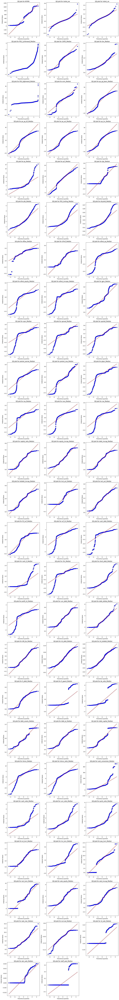

In [11]:
n = len(df.columns)
ncols = 3
nrows = n // ncols if n % ncols == 0 else n // ncols + 1


fig, axs = plt.subplots(nrows, ncols, figsize=(15, nrows*5))
axs = axs.flatten()

for i, column in enumerate(df.columns):
    probplot(df[column], plot=axs[i])
    axs[i].set_title(f'QQ plot for {column}')

for i in range(n, nrows*ncols):
    fig.delaxes(axs[i])

plt.tight_layout()
plt.show()

## Results

In most cases data seems to follow a standard distributions. 
**TODO:** Further analysis needed per Sector. Also, analyse if there is any data transformation that would benefit

# Correlation (Scatter Plots)

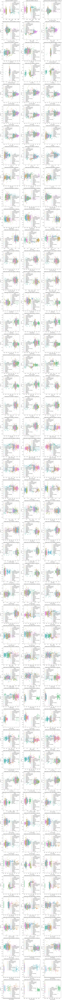

In [12]:
parameters = [x for x in df.columns if x not in target_columns]

n = len(parameters) * len(target_columns)
ncols = 3
nrows = n // ncols if n % ncols == 0 else n // ncols + 1

fig, axs = plt.subplots(nrows, ncols, figsize=(15, nrows*5))
axs = axs.flatten()

for i, (parameter, target) in enumerate([(p, t) for p in parameters for t in target_columns]):
    sns.scatterplot(data=df.reset_index(), x=parameter, y=target, hue=sector_column, ax=axs[i])
    axs[i].set_title(f'Scatter plot of {parameter} vs {target}')

for i in range(n, nrows*ncols):
    fig.delaxes(axs[i])

plt.tight_layout()
plt.show()

## Results
**TODO:** More Analysis Required. No claims for now. Also look at lagged correlations.

# Time Series Decomposition

In [13]:
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf

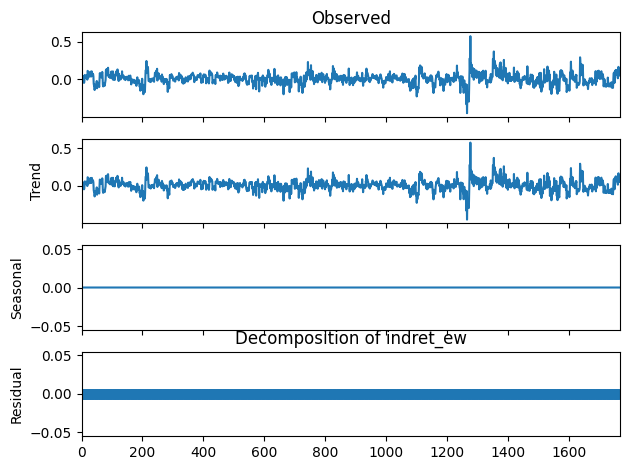

<Figure size 1000x500 with 0 Axes>

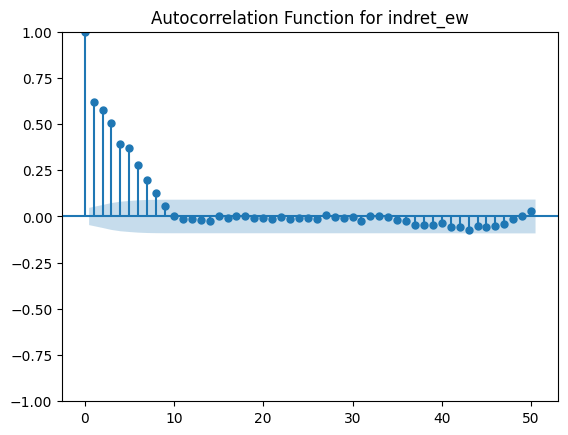

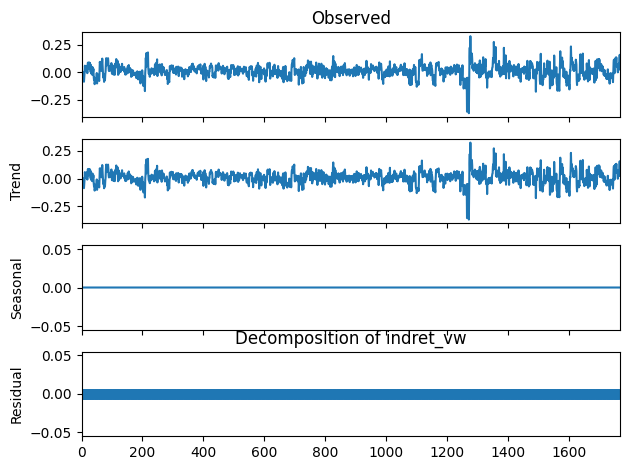

<Figure size 1000x500 with 0 Axes>

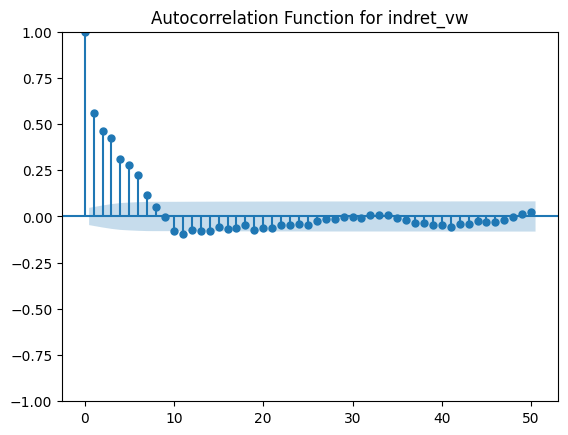

In [22]:
for target in target_columns:
    result = seasonal_decompose(df[target].values, model='additive', period=1)

    result.plot()
    plt.title('Decomposition of ' + target)
    
    plt.figure(figsize=(10,5))
    plot_acf(df[target].values, lags=50)
    plt.title('Autocorrelation Function for ' + target)
    
    plt.show()

Decomposition of indret_ew for Communication Services


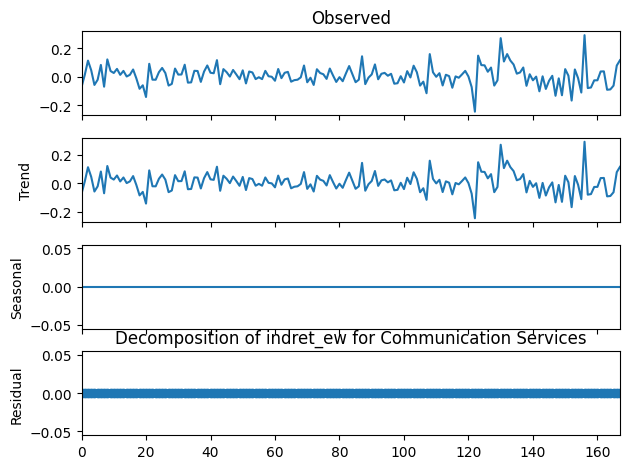

<Figure size 1000x500 with 0 Axes>

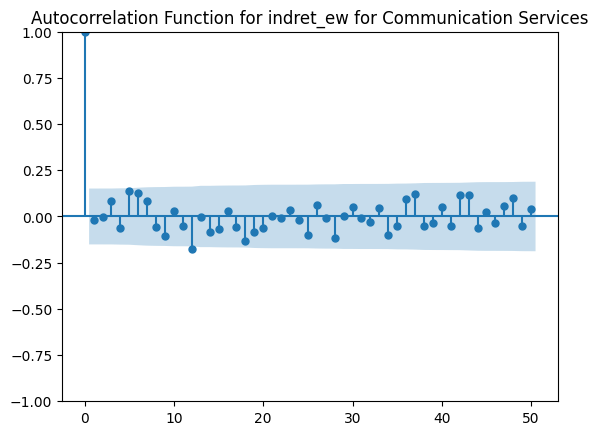

Decomposition of indret_vw for Communication Services


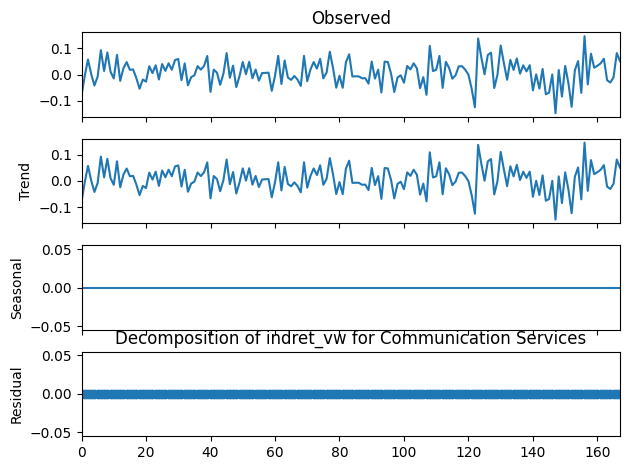

<Figure size 1000x500 with 0 Axes>

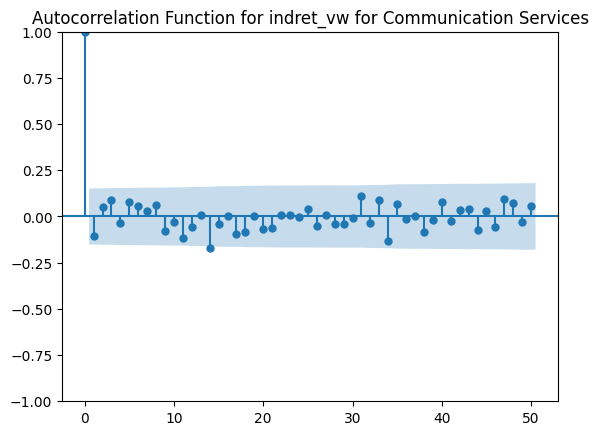

Decomposition of indret_ew for Consumer Discretionary


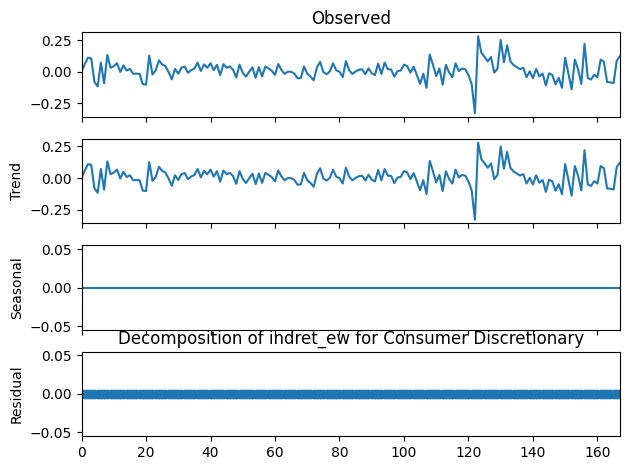

<Figure size 1000x500 with 0 Axes>

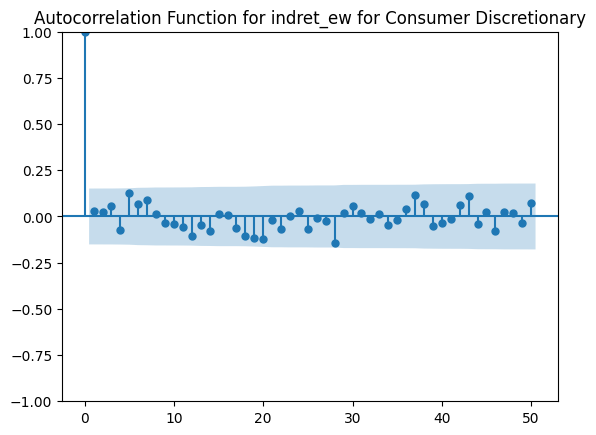

Decomposition of indret_vw for Consumer Discretionary


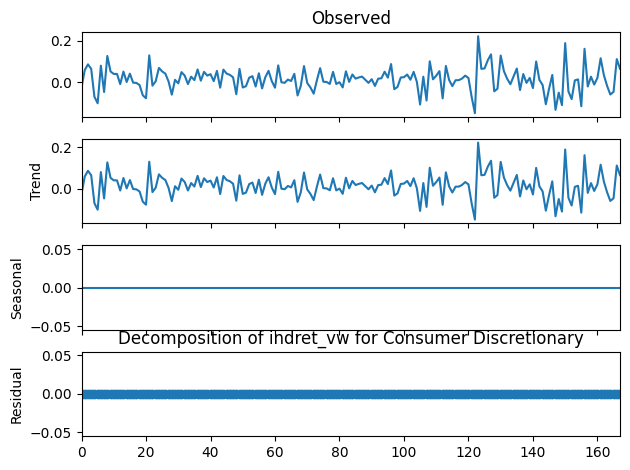

<Figure size 1000x500 with 0 Axes>

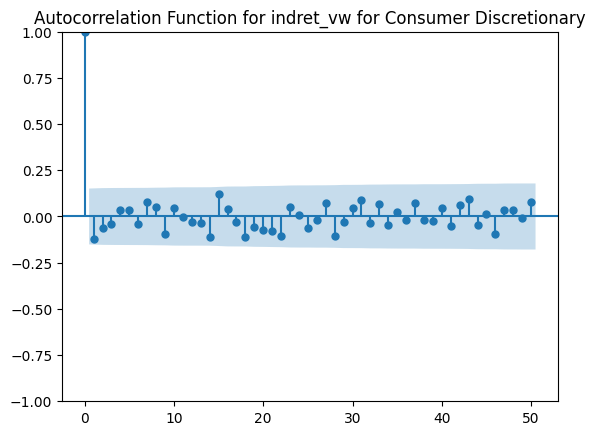

Decomposition of indret_ew for Consumer Staples


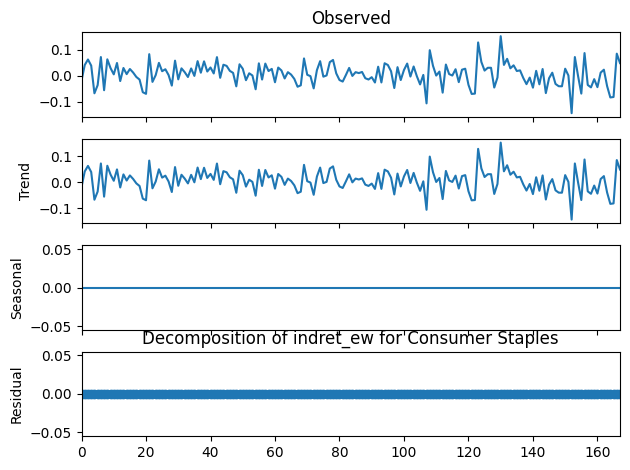

<Figure size 1000x500 with 0 Axes>

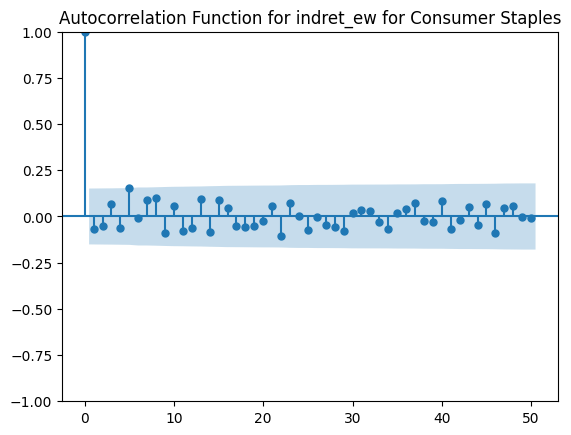

Decomposition of indret_vw for Consumer Staples


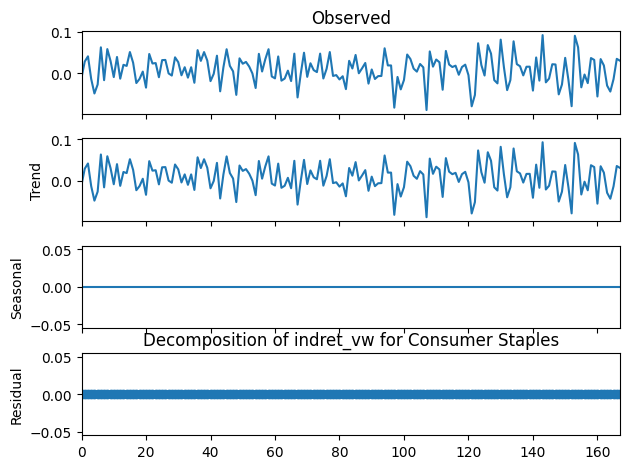

<Figure size 1000x500 with 0 Axes>

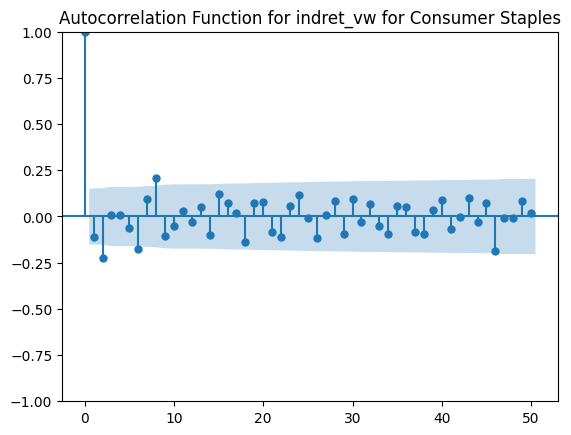

Decomposition of indret_ew for Energy


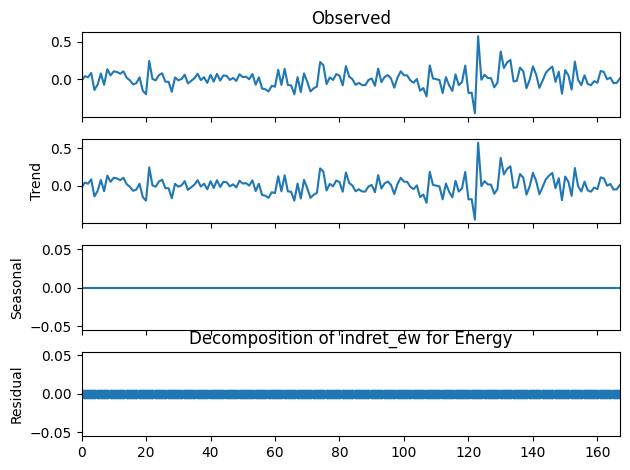

<Figure size 1000x500 with 0 Axes>

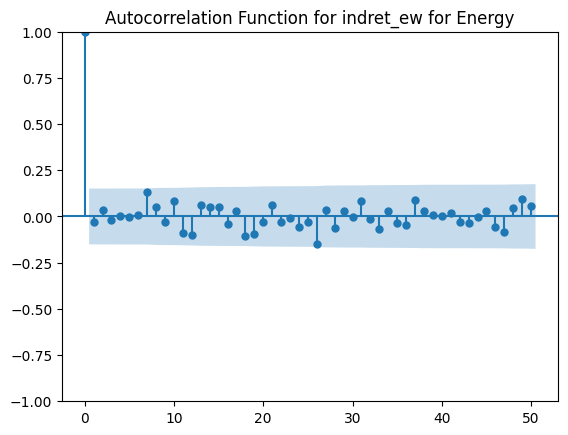

Decomposition of indret_vw for Energy


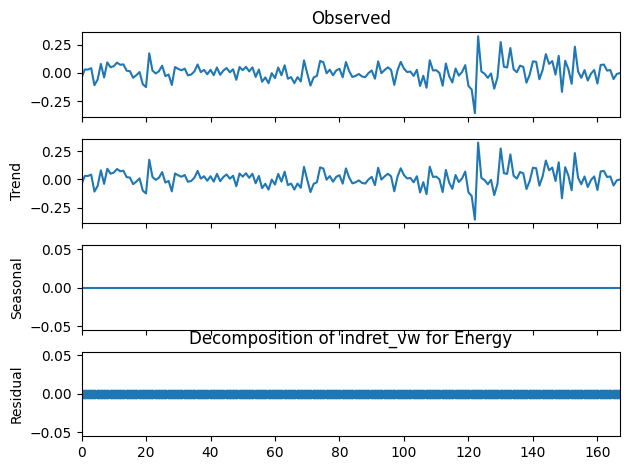

<Figure size 1000x500 with 0 Axes>

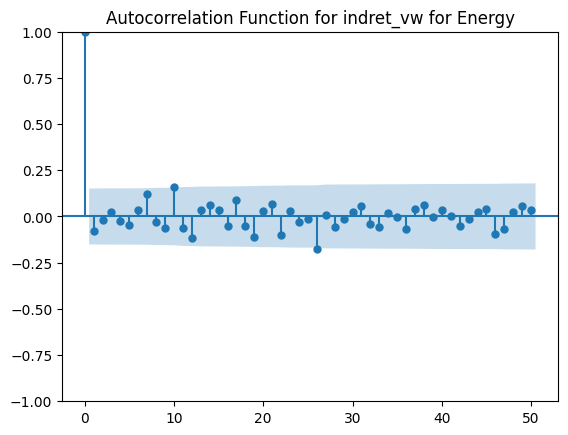

Decomposition of indret_ew for Financials


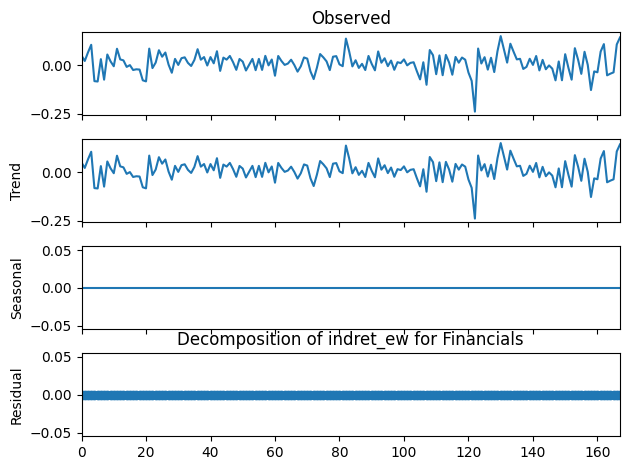

<Figure size 1000x500 with 0 Axes>

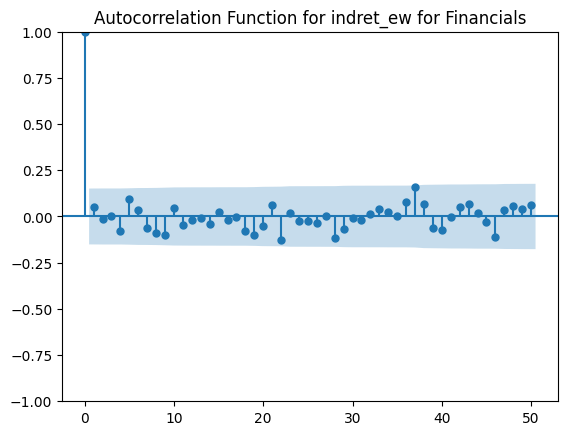

Decomposition of indret_vw for Financials


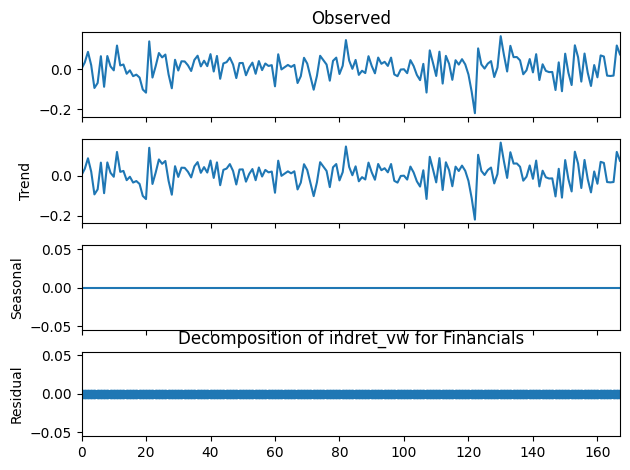

<Figure size 1000x500 with 0 Axes>

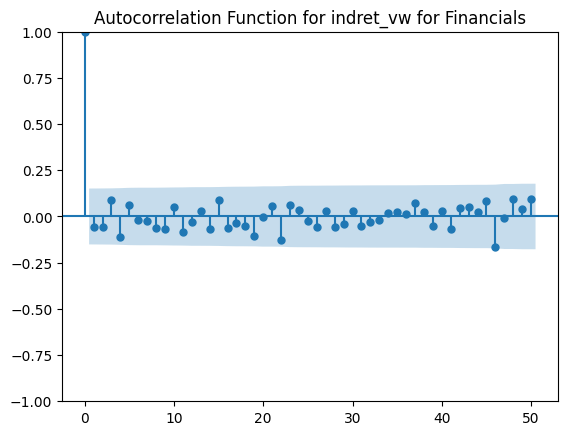

Decomposition of indret_ew for Health Care


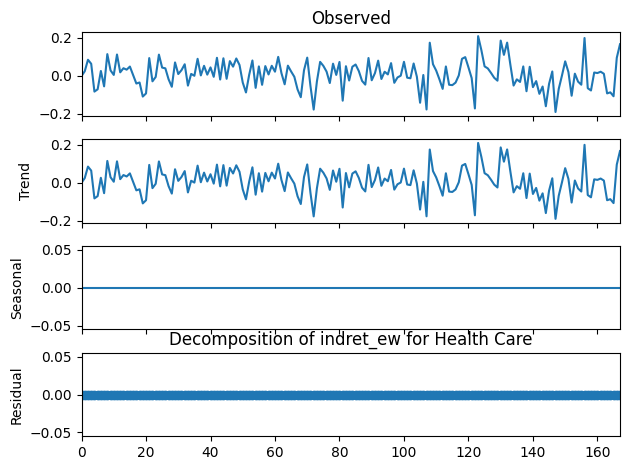

<Figure size 1000x500 with 0 Axes>

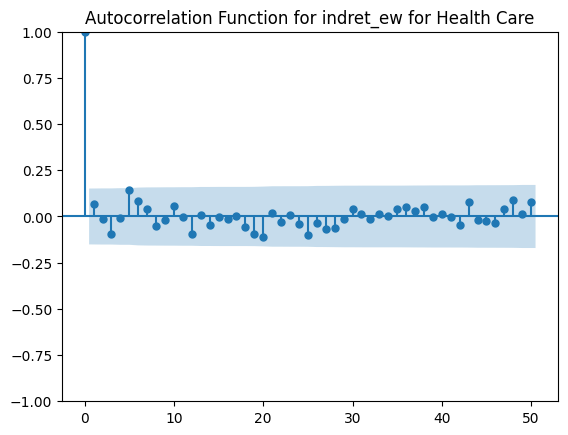

Decomposition of indret_vw for Health Care


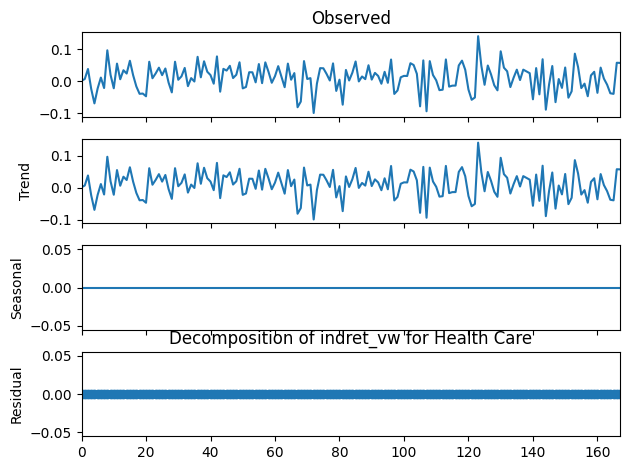

<Figure size 1000x500 with 0 Axes>

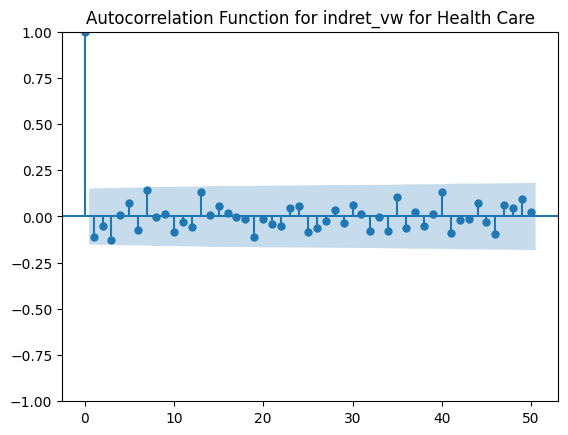

Decomposition of indret_ew for Industrials


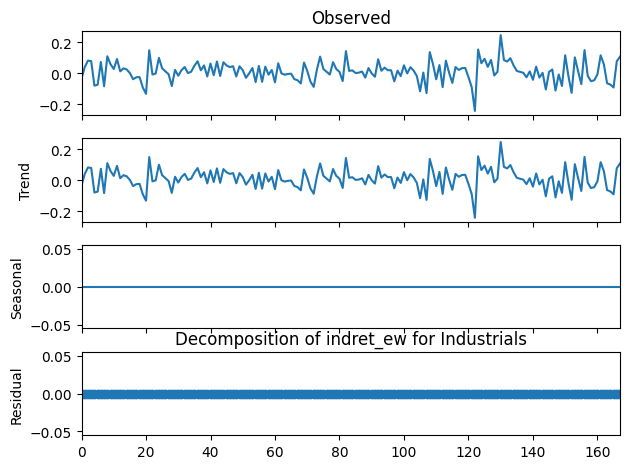

<Figure size 1000x500 with 0 Axes>

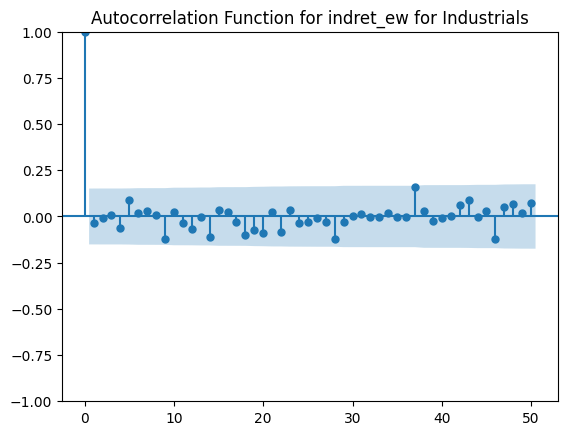

Decomposition of indret_vw for Industrials


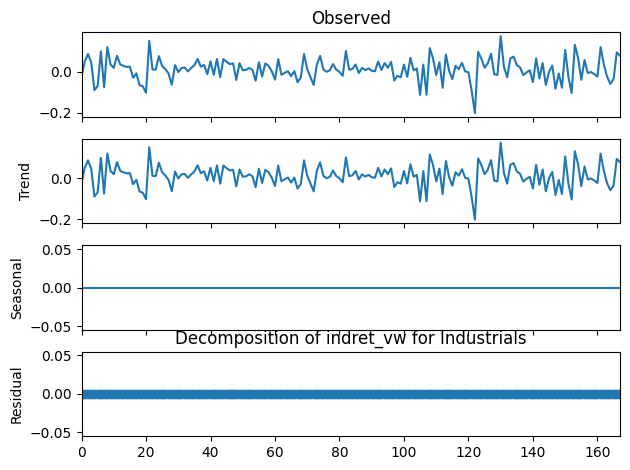

<Figure size 1000x500 with 0 Axes>

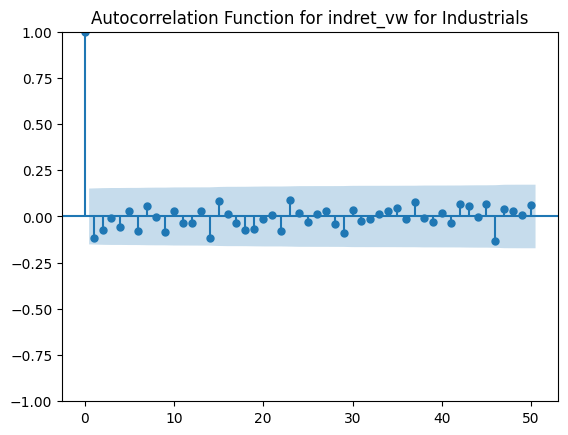

Decomposition of indret_ew for Information Technology


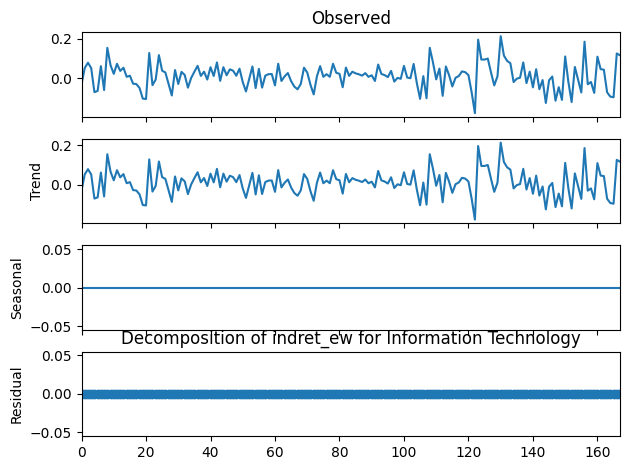

<Figure size 1000x500 with 0 Axes>

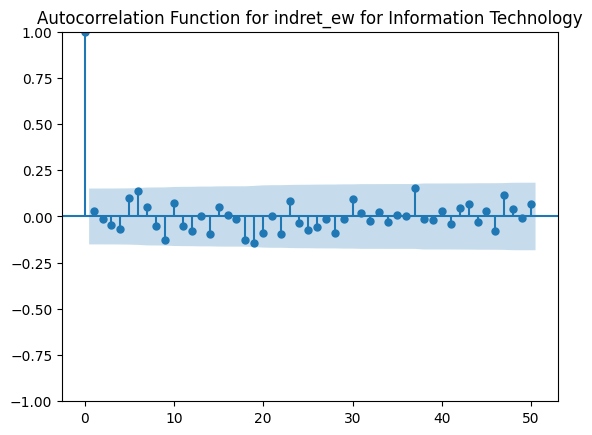

Decomposition of indret_vw for Information Technology


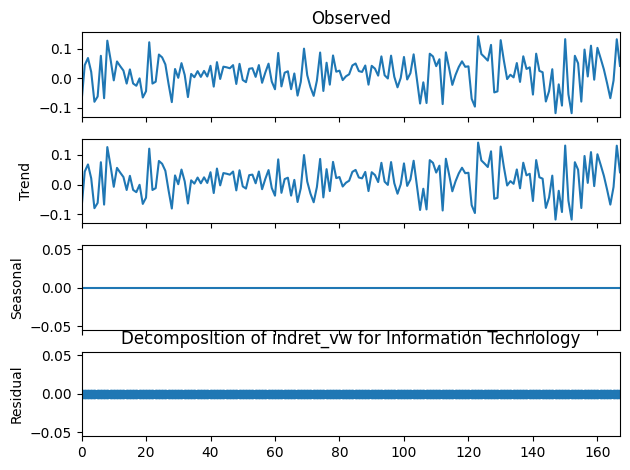

<Figure size 1000x500 with 0 Axes>

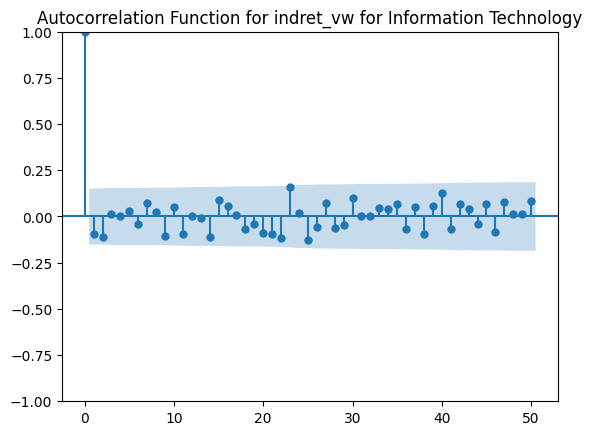

Decomposition of indret_ew for Materials


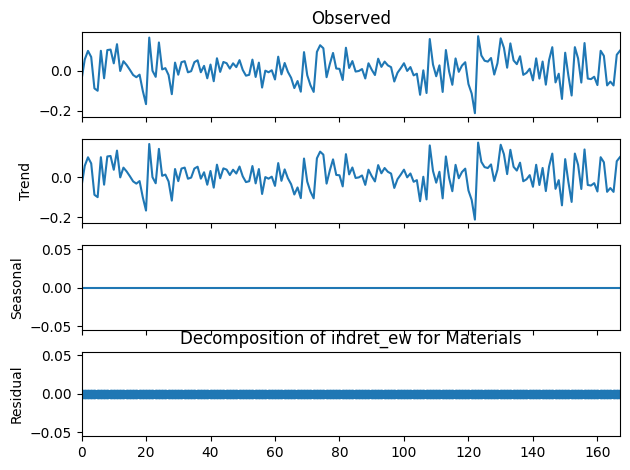

<Figure size 1000x500 with 0 Axes>

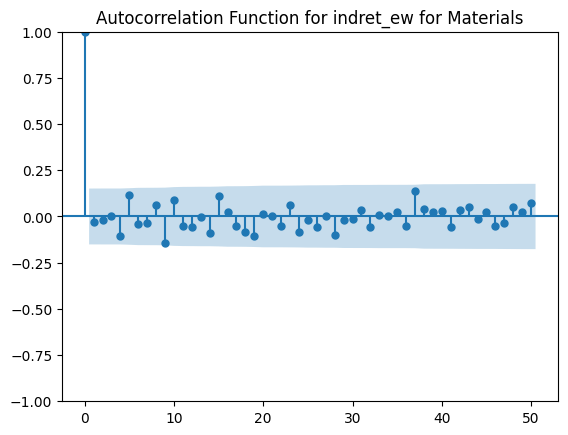

Decomposition of indret_vw for Materials


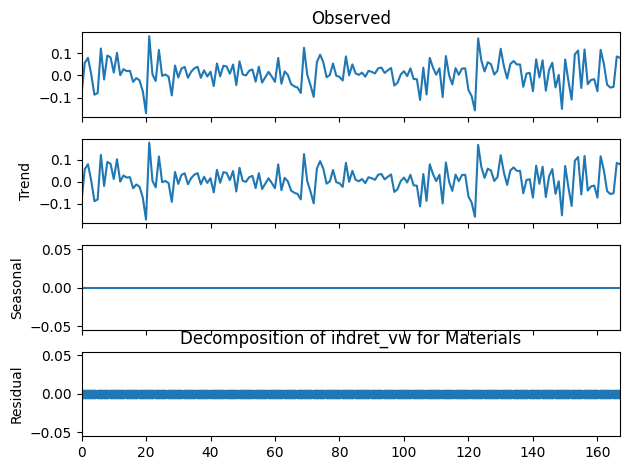

<Figure size 1000x500 with 0 Axes>

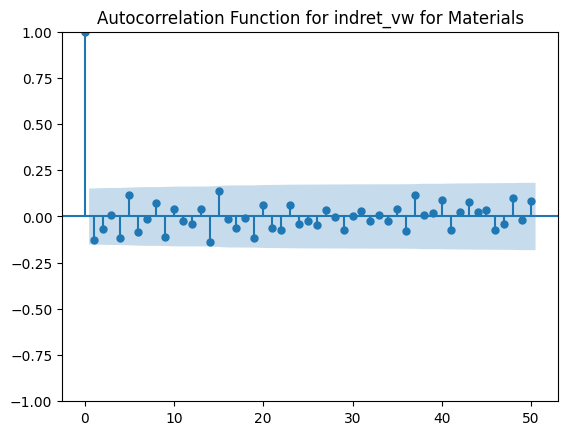

Decomposition of indret_ew for Real Estate


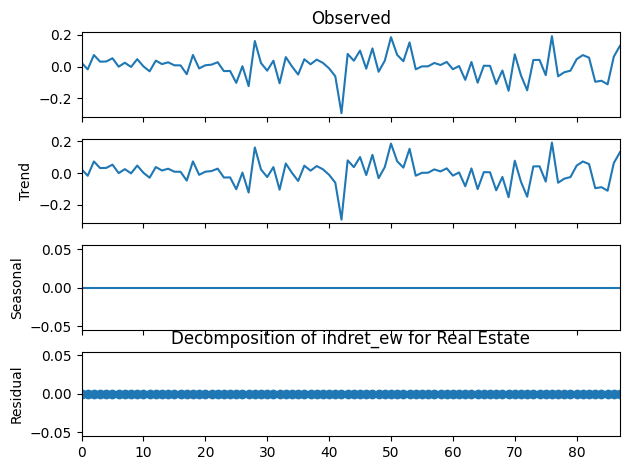

<Figure size 1000x500 with 0 Axes>

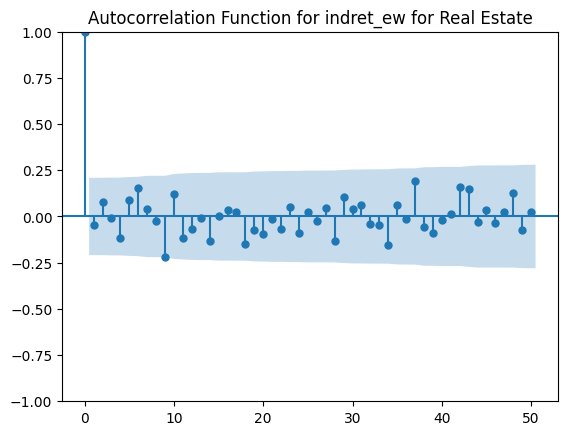

Decomposition of indret_vw for Real Estate


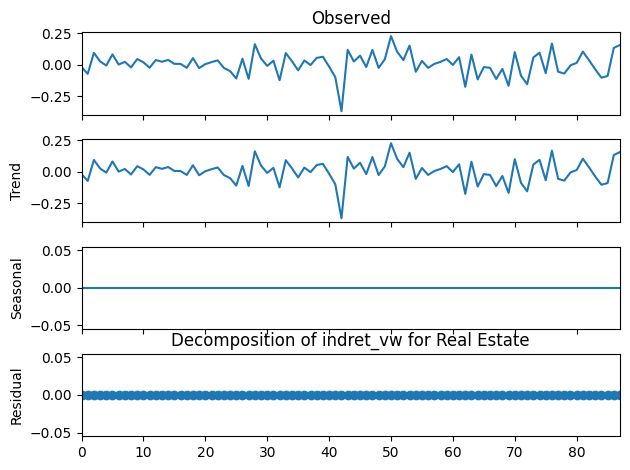

<Figure size 1000x500 with 0 Axes>

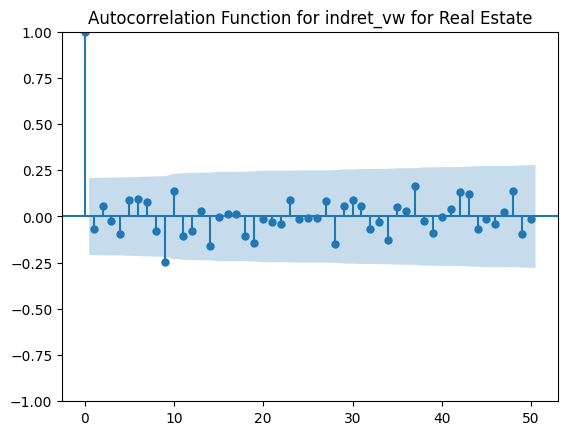

Decomposition of indret_ew for Utilities


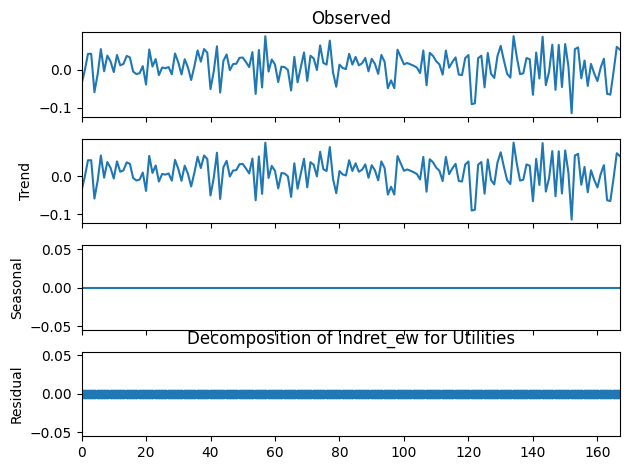

<Figure size 1000x500 with 0 Axes>

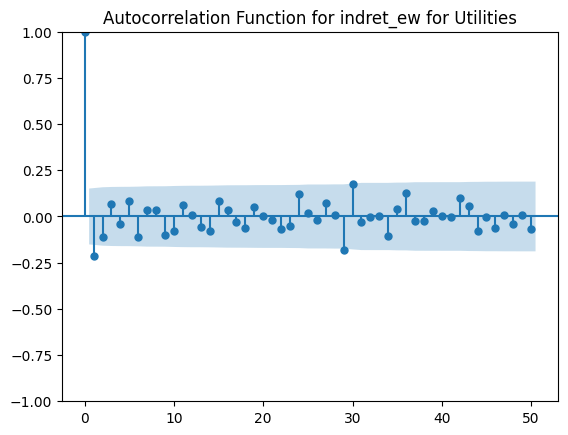

Decomposition of indret_vw for Utilities


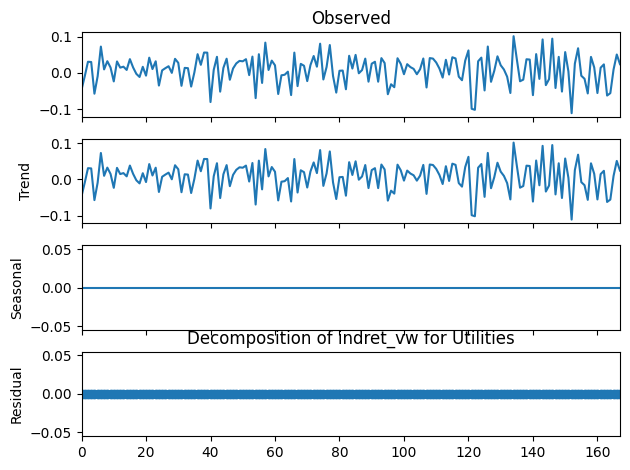

<Figure size 1000x500 with 0 Axes>

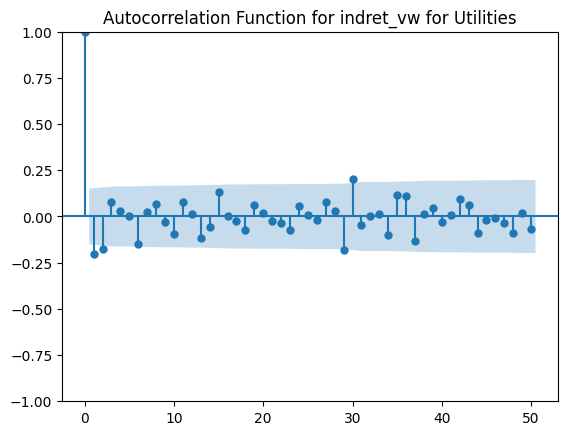

In [15]:
grouped = df.groupby(sector_column)

for sector, group in grouped:
    for target in target_columns:
        print(f"Decomposition of {target} for {sector}")
        result = seasonal_decompose(group[target].dropna().values, model='additive', period=1)

        result.plot()
        plt.title('Decomposition of ' + target + ' for ' + sector)
        
        plt.figure(figsize=(10,5))
        plot_acf(group[target].dropna(), lags=50)
        plt.title('Autocorrelation Function for ' + target + ' for ' + sector)
        
        plt.show()

## Result
More steps needed for claims as of now. However, seems to be autocorrelation, at least partial.

# Basic Models

In [16]:
from statsmodels.tsa.arima.model import ARIMA
from arch import arch_model
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression

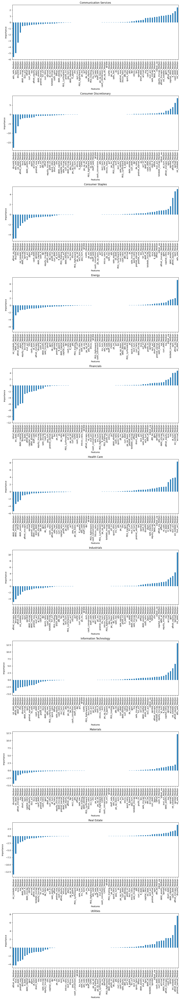

In [17]:
grouped = df.groupby(sector_column)
target_column = target_columns[0]

feature_importances = []

for name, group in grouped:
    X = group.drop([target_column], axis=1).ffill()
    y = group[target_column]

    model = LinearRegression()

    model.fit(X, y)

    importance = model.coef_
    feature_importances.append(importance)

# Convert the list to a DataFrame
feature_importances_df = pd.DataFrame(feature_importances, columns=X.columns, index=grouped.groups.keys())
feature_importances_df = feature_importances_df.reset_index().rename(columns={'index': 'Sector'})

n_sectors = feature_importances_df['Sector'].nunique()

fig, axes = plt.subplots(nrows=n_sectors, figsize=(12, 6*n_sectors))

# Iterate over sectors and create a bar plot for each one
for (sector, data), ax in zip(feature_importances_df.melt(id_vars='Sector').groupby('Sector'), axes.flatten()):
    data = data.sort_values(by='value')
    data.plot(x='variable', y='value', kind='bar', ax=ax, legend=False)
    ax.set_title(sector)
    ax.set_xlabel('Features')
    ax.set_ylabel('Importance')

plt.tight_layout()
plt.show()

## Result:
The feature importance will help to further the analysis process. For now, some features seem to be consistent across sectors, while others are more variable between them.

In [18]:
# feature_columns = [col for col in df.columns if col not in target_columns + [sector_column]]

# scores = {}
# grouped = df.groupby(sector_column)

# for sector, group in grouped:
#     for target in target_columns:
#         # Fit the ARIMA model
#         arima_model = ARIMA(group[target].dropna(), order=(1, 1, 1))
#         arima_result = arima_model.fit()

#         # Fit the GARCH model
#         garch_model = arch_model(arima_result.resid, vol='Garch', p=1, q=1)
#         garch_result = garch_model.fit(disp='off')

#         # Print the summary of the GARCH model
#         print(f'GARCH Model for {target} in {sector}:\n')
#         print(garch_result.summary())

In [19]:
# scores = []
# grouped = df.groupby(sector_column)

# for sector, group in grouped:
#     for target in target_columns:
#         # Split the data into training and testing sets
#         train = group[target].dropna()[:-10]
#         test = group[target].dropna()[-10:]

#         # Fit the ARIMA model
#         arima_model = ARIMA(train, order=(1, 1, 1))
#         arima_result = arima_model.fit()

#         # Make predictions
#         arima_pred = arima_result.predict(start=len(train), end=len(train)+len(test)-1)

#         # Fit the GARCH model
#         garch_model = arch_model(arima_result.resid, vol='Garch', p=1, q=1)
#         garch_result = garch_model.fit(disp='off')

#         # Make predictions
#         garch_pred = garch_result.forecast(start=0, horizon=len(test)).variance[-1:].values[0]

#         # Calculate the RMSE
#         arima_rmse = mean_squared_error(test, arima_pred, squared=False)
#         garch_rmse = mean_squared_error(test, garch_pred, squared=False)

#         # Append the scores
#         scores.append([sector, target, 'ARIMA', arima_rmse])
#         scores.append([sector, target, 'GARCH', garch_rmse])

#        # Plot the predictions and actual values
#         plt.figure(figsize=(10, 6))
#         plt.plot(test.index.get_level_values(1), test, label='Actual')
#         plt.plot(test.index.get_level_values(1), arima_pred, label='ARIMA Predictions')
#         plt.plot(test.index.get_level_values(1), garch_pred, label='GARCH Predictions')
#         plt.legend()
#         plt.title(f'{sector} - {target}')
#         plt.show()
#         break

# scores_df = pd.DataFrame(scores, columns=['Sector', 'Target', 'Model', 'Score'])
# display(scores_df)